In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
df = pd.read_csv("fm data/data.csv")
df = df[df.year.str.contains("20") == True]
df

,Unnamed: 0,name,country,club,age,position,wage,value,cost,expires,...,balance,wagebudget,trainingfacilities,youthfacilities,youthacademy,stadiumcap,avgattendance,ability,potential.1,Unnamed: 28
0,NaN,Aníbal Capela,Portugal,Associação Académica de Coimbra,22,D C,£840,£90k,£139k,29-06-2017,...,£592k,£6k,16.0,15.0,15.0,14500.0,4494.0,62.9,64.79,NaN
1,NaN,Cleyton,NaN,Associação Académica de Coimbra,23,AM C,£840,£113k,£58k,04-07-2016,...,£592k,£6k,16.0,15.0,15.0,14500.0,4494.0,62.9,64.79,NaN
2,NaN,Diogo Valente,Portugal,Associação Académica de Coimbra,28,AM L,£2k,£545k,£678k,29-06-2015,...,£592k,£6k,16.0,15.0,15.0,14500.0,4494.0,62.9,64.79,NaN
3,NaN,Djavan,NaN,Associação Académica de Coimbra,25,D/WB/M L,£610,£26k,£12k,25-01-2016,...,£592k,£6k,16.0,15.0,15.0,14500.0,4494.0,62.9,64.79,NaN
4,NaN,Elton Monteiro,NaN,Associação Académica de Coimbra,19,D C,£2k,£145k,£285k,29-06-2016,...,£592k,£6k,16.0,15.0,15.0,14500.0,4494.0,62.9,64.79,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65531,NaN,Omar,NaN,Real Betis B. SAD,18,D C,£670,£123k,£262k,29-06-2016,...,£4m,£0,14.0,13.0,13.0,55000.0,36000.0,75.3,78.00,NaN
65532,NaN,Pablo Piqueres,NaN,Real Betis B. SAD,17,D C,£280,£23k,£46k,29-06-2016,...,£4m,£0,14.0,13.0,13.0,55000.0,36000.0,75.3,78.00,NaN
65533,NaN,Pedro,NaN,Real Betis B. SAD,19,GK,£530,£94k,£177k,29-06-2016,...,£4m,£0,14.0,13.0,13.0,55000.0,36000.0,75.3,78.00,NaN
65534,NaN,Petros,NaN,Real Betis B. SAD,25,DM,£18k,£5m,£6m,29-06-2019,...,£4m,£0,14.0,13.0,13.0,55000.0,36000.0,75.3,78.00,NaN


In [3]:
list(df)

['Unnamed: 0',
 'name',
 'country',
 'club',
 'age',
 'position',
 'wage',
 'value',
 'cost',
 'expires',
 'rating',
 'potential',
 'injprone',
 'year',
 'club.1',
 'clubcountry',
 'league',
 'reputation',
 'avgage',
 'balance',
 'wagebudget',
 'trainingfacilities',
 'youthfacilities',
 'youthacademy',
 'stadiumcap',
 'avgattendance',
 'ability',
 'potential.1',
 'Unnamed: 28']

In [4]:
df[['A', 'B', 'C']] = df.expires.str.split('-', 2, expand=True)
df = df[df.C.str.contains("20") == True]
df['length'] = df.C.astype(int) - df.year.astype(int) + 1
df = df[df.length > 0]

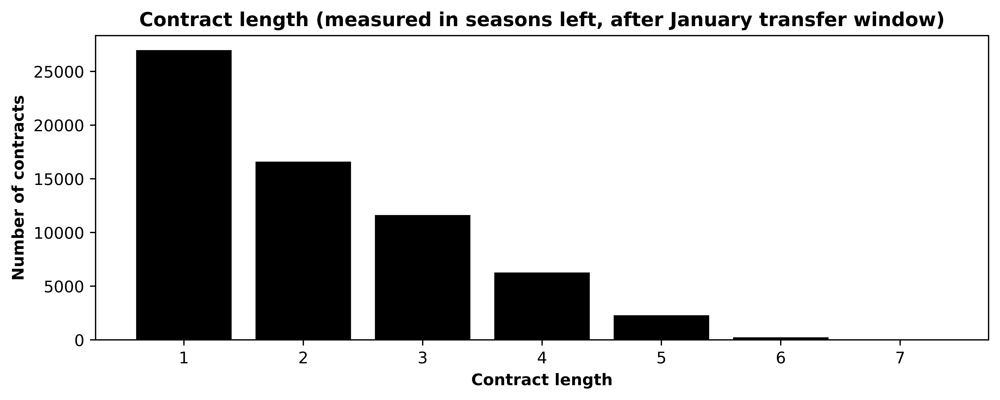

In [5]:
plt.style.use('grayscale')
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['figure.dpi'] = 1080
plt.rcParams['figure.figsize'] = (10,3.5)

plt.bar(df.length.value_counts().index, df.length.value_counts())
plt.title('Contract length (measured in seasons left, after January transfer window)', fontweight='bold')
plt.ylabel('Number of contracts', fontweight='bold')
plt.xlabel('Contract length', fontweight='bold')

plt.savefig('img/003-1ContractLength.eps', format='eps', bbox_inches='tight')

In [6]:
df.ability = df.ability.astype(int)
df.wage = df.wage.str.replace('£','').str.replace('k','000').astype(int)
df.avgattendance = df.avgattendance.astype(int)
df.value = df.value.str.replace('£','').str.replace('k','000').str.replace('m','000000').astype(int)

In [7]:
plt.style.use('grayscale')
plt.rcParams['figure.facecolor'] = 'white'
plt.rcParams['figure.dpi'] = 1080
plt.rcParams['figure.figsize'] = (10,8)

plt.subplot(4,1,1)
for value in df.ability.unique():
    plt.boxplot(df[df.ability == value]['wage'], positions=[value])
plt.subplot(4,1,2)
plt.scatter(df.avgattendance, df.wage, alpha = 0.5)
plt.subplot(4,1,3)
plt.scatter(df.value, df.wage, alpha = 0.5)
plt.subplot(4,1,4)
for value in df.length.unique():
    plt.boxplot(df[df.length == value]['wage'], positions=[value])